In [1]:
!python --version

Python 3.8.3


In [2]:
!pip install numpy

In [8]:
!pip install opencv-python==4.1.2.30

In [3]:
import sys; print(sys.executable)

C:\Users\lkk\Documents\Developer\.venv\Scripts\python.exe


In [10]:
!pip install numpy vtk pyqt5

In [11]:
#Install Mayavi, https://docs.enthought.com/mayavi/mayavi/installation.html
! pip install mayavi

In [12]:
!pip install PyQt5

In [13]:
!pip install scipy ipywidgets ipyevents

In [14]:
!jupyter nbextension install --py mayavi --user

Installing c:\users\lkk\documents\developer\.venv\lib\site-packages\mayavi\tools/static -> mayavi
Making directory: C:\Users\lkk\AppData\Roaming\jupyter\nbextensions\mayavi\
Making directory: C:\Users\lkk\AppData\Roaming\jupyter\nbextensions\mayavi\x3d
Copying: c:\users\lkk\documents\developer\.venv\lib\site-packages\mayavi\tools\static\x3d\LICENSE.txt -> C:\Users\lkk\AppData\Roaming\jupyter\nbextensions\mayavi\x3d\LICENSE.txt
Copying: c:\users\lkk\documents\developer\.venv\lib\site-packages\mayavi\tools\static\x3d\x3dom.css -> C:\Users\lkk\AppData\Roaming\jupyter\nbextensions\mayavi\x3d\x3dom.css
Copying: c:\users\lkk\documents\developer\.venv\lib\site-packages\mayavi\tools\static\x3d\x3dom.js -> C:\Users\lkk\AppData\Roaming\jupyter\nbextensions\mayavi\x3d\x3dom.js
- Validating: ok

    To initialize this nbextension in the browser every time the notebook (or other app) loads:
    
          jupyter nbextension enable mayavi --user --py
    


In [15]:
!jupyter nbextension enable --py mayavi --user

Enabling notebook extension mayavi/x3d/x3dom...
      - Validating: ok


# Test Mayavi and show kitti groundtruth
from: https://github.com/kuixu/kitti_object_vis/blob/master/jupyter/test_mayavi.ipynb

https://github.com/kuixu/kitti_object_vis/blob/master/notebook_demo.ipynb

In [10]:
# Create the data.
from numpy import pi, sin, cos, mgrid
dphi, dtheta = pi/250.0, pi/250.0
[phi,theta] = mgrid[0:pi+dphi*1.5:dphi,0:2*pi+dtheta*1.5:dtheta]
m0 = 4; m1 = 3; m2 = 2; m3 = 3; m4 = 6; m5 = 2; m6 = 6; m7 = 4;
r = sin(m0*phi)**m1 + cos(m2*phi)**m3 + sin(m4*theta)**m5 + cos(m6*theta)**m7
x = r*sin(phi)*cos(theta)
y = r*cos(phi)
z = r*sin(phi)*sin(theta)

# View it.
from mayavi import mlab
s = mlab.mesh(x, y, z)
mlab.show()

In [1]:
def draw_lidar(
    pc,
    color=None,
    fig=None,
    bgcolor=(0, 0, 0),
    pts_scale=0.3,
    pts_mode="sphere",
    pts_color=None,
    color_by_intensity=False,
    pc_label=False,
):
    """ Draw lidar points
    Args:
        pc: numpy array (n,3) of XYZ
        color: numpy array (n) of intensity or whatever
        fig: mayavi figure handler, if None create new one otherwise will use it
    Returns:
        fig: created or used fig
    """
    # ind = (pc[:,2]< -1.65)
    # pc = pc[ind]
    pts_mode = "point"
    print("====================", pc.shape)
    if fig is None:
        fig = mlab.figure(
            figure=None, bgcolor=bgcolor, fgcolor=None, engine=None, size=(1600, 1000)
        )
    if color is None:
        color = pc[:, 2]
    if pc_label:
        color = pc[:, 4]
    if color_by_intensity:
        color = pc[:, 2]

    mlab.points3d(
        pc[:, 0],
        pc[:, 1],
        pc[:, 2],
        color,
        color=pts_color,
        mode=pts_mode,
        colormap="gnuplot",
        scale_factor=pts_scale,
        figure=fig,
    )

    # draw origin
    mlab.points3d(0, 0, 0, color=(1, 1, 1), mode="sphere", scale_factor=0.2)

    # draw axis
    axes = np.array(
        [[2.0, 0.0, 0.0, 0.0], [0.0, 2.0, 0.0, 0.0], [0.0, 0.0, 2.0, 0.0]],
        dtype=np.float64,
    )
    mlab.plot3d(
        [0, axes[0, 0]],
        [0, axes[0, 1]],
        [0, axes[0, 2]],
        color=(1, 0, 0),
        tube_radius=None,
        figure=fig,
    )
    mlab.plot3d(
        [0, axes[1, 0]],
        [0, axes[1, 1]],
        [0, axes[1, 2]],
        color=(0, 1, 0),
        tube_radius=None,
        figure=fig,
    )
    mlab.plot3d(
        [0, axes[2, 0]],
        [0, axes[2, 1]],
        [0, axes[2, 2]],
        color=(0, 0, 1),
        tube_radius=None,
        figure=fig,
    )

    # draw fov (todo: update to real sensor spec.)
    fov = np.array(
        [[20.0, 20.0, 0.0, 0.0], [20.0, -20.0, 0.0, 0.0]], dtype=np.float64  # 45 degree
    )

    mlab.plot3d(
        [0, fov[0, 0]],
        [0, fov[0, 1]],
        [0, fov[0, 2]],
        color=(1, 1, 1),
        tube_radius=None,
        line_width=1,
        figure=fig,
    )
    mlab.plot3d(
        [0, fov[1, 0]],
        [0, fov[1, 1]],
        [0, fov[1, 2]],
        color=(1, 1, 1),
        tube_radius=None,
        line_width=1,
        figure=fig,
    )

    # draw square region
    TOP_Y_MIN = -20
    TOP_Y_MAX = 20
    TOP_X_MIN = 0
    TOP_X_MAX = 40
    #TOP_Z_MIN = -2.0
    #TOP_Z_MAX = 0.4

    x1 = TOP_X_MIN
    x2 = TOP_X_MAX
    y1 = TOP_Y_MIN
    y2 = TOP_Y_MAX
    mlab.plot3d(
        [x1, x1],
        [y1, y2],
        [0, 0],
        color=(0.5, 0.5, 0.5),
        tube_radius=0.1,
        line_width=1,
        figure=fig,
    )
    mlab.plot3d(
        [x2, x2],
        [y1, y2],
        [0, 0],
        color=(0.5, 0.5, 0.5),
        tube_radius=0.1,
        line_width=1,
        figure=fig,
    )
    mlab.plot3d(
        [x1, x2],
        [y1, y1],
        [0, 0],
        color=(0.5, 0.5, 0.5),
        tube_radius=0.1,
        line_width=1,
        figure=fig,
    )
    mlab.plot3d(
        [x1, x2],
        [y2, y2],
        [0, 0],
        color=(0.5, 0.5, 0.5),
        tube_radius=0.1,
        line_width=1,
        figure=fig,
    )

    # mlab.orientation_axes()
    mlab.view(
        azimuth=180,
        elevation=70,
        focalpoint=[12.0909996, -1.04700089, -2.03249991],
        distance=62.0,
        figure=fig,
    )
    return fig

In [2]:
import numpy as np
import os

In [3]:
path = r'D:\\Dataset\\WaymoKittitraining_0000\\'+'velodyne'

idx=30
lidar_filename = os.path.join(path, "%06d.bin" % (idx))
print(lidar_filename)

dtype=np.float32
n_vec=4
scan = np.fromfile(lidar_filename, dtype=dtype)
pc_velo = scan.reshape((-1, n_vec))

D:\\Dataset\\WaymoKittitraining_0000\\velodyne\000030.bin


In [4]:
pc_velo.shape

(168255, 4)

In [6]:
import mayavi.mlab as mlab
# import sys
fig = mlab.figure(
    figure=None, bgcolor=(0, 0, 0), fgcolor=None, engine=None, size=(1000, 500)
)
# if "mlab" not in sys.modules:
#     import mayavi.mlab as mlab
draw_lidar(pc_velo, fig=fig, pc_label=False)
mlab.show()
# input_str = raw_input()
#mlab.clf()

==================== (168255, 4)


## Read label and Image

In [7]:
import pandas as pd

def read_label_3d(label_file):
    """Read and parse label information of kitti 3d object detection dataset.
  
    :param label_file: filname like kitti_3d/{training,testing}/label_2/id.txt
    Returns Pandas DataFrame
    Data Format Description
    =======================
    The data for training and testing can be found in the corresponding folders.
    The sub-folders are structured as follows:
      - image_02/ contains the left color camera images (png)
      - label_02/ contains the left color camera label files (plain text files)
      - calib/ contains the calibration for all four cameras (plain text file)
    The label files contain the following information, which can be read and
    written using the matlab tools (readLabels.m, writeLabels.m) provided within
    this devkit. All values (numerical or strings) are separated via spaces,
    each row corresponds to one object. The 15 columns represent:
    #Values    Name      Description
    ----------------------------------------------------------------------------
       1    type         Describes the type of object: 'Car', 'Van', 'Truck',
                         'Pedestrian', 'Person_sitting', 'Cyclist', 'Tram',
                         'Misc' or 'DontCare'
       1    truncated    Float from 0 (non-truncated) to 1 (truncated), where
                         truncated refers to the object leaving image boundaries
       1    occluded     Integer (0,1,2,3) indicating occlusion state:
                         0 = fully visible, 1 = partly occluded
                         2 = largely occluded, 3 = unknown
       1    alpha        Observation angle of object, ranging [-pi..pi]
       4    bbox         2D bounding box of object in the image (0-based index):
                         contains left, top, right, bottom pixel coordinates
       3    dimensions   3D object dimensions: height, width, length (in meters)
       3    location     3D object location x,y,z in camera coordinates (in meters)
       1    rotation_y   Rotation ry around Y-axis in camera coordinates [-pi..pi]
       1    score        Only for results: Float, indicating confidence in
                         detection, needed for p/r curves, higher is better.
    """
    return pd.read_csv(label_file, sep=" ", names=['label', 'truncated', 'occluded', 'alpha', 'bbox_xmin', 'bbox_ymin', 'bbox_xmax', 'bbox_ymax', 'dim_height', 'dim_width', 'dim_length', 'loc_x', 'loc_y', 'loc_z', 'rotation_y', 'score'])

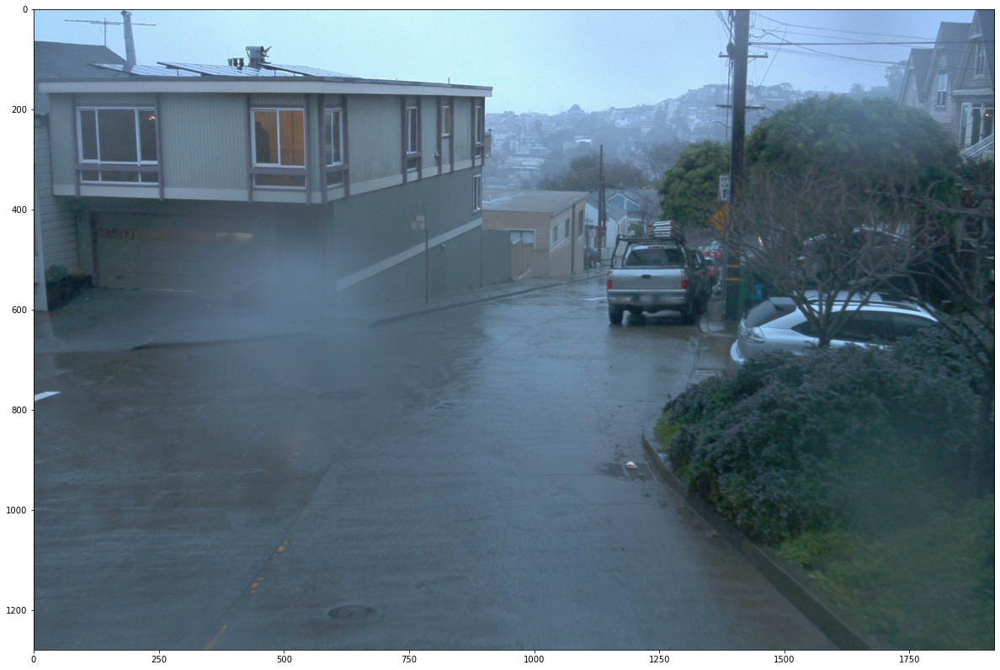

In [17]:
import cv2
import os
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (25, 14)

Basepath=r'D:\\Dataset\\WaymoKittitraining_0000\\'
idx=7
filename="%06d.png" % (idx)
image_file = path = os.path.join(Basepath, 'image_0', filename)
calibration_file = os.path.join(Basepath, 'calib', filename.replace('png', 'txt'))
label_file = os.path.join(Basepath, 'label_0', filename.replace('png', 'txt'))
labels = read_label_3d(label_file)
img = cv2.imread(image_file)

rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_height, img_width, img_channel = rgb.shape
plt.imshow(rgb)

In [18]:
filename

'000007.png'

In [9]:
labels

,label,truncated,occluded,alpha,bbox_xmin,bbox_ymin,bbox_xmax,bbox_ymax,dim_height,dim_width,dim_length,loc_x,loc_y,loc_z,rotation_y,score
0,Car,0,0,-10,0,0,0,0,3.20,2.37,6.14,3.68,0.08,26.21,-1.31,NaN
1,Car,0,0,-10,0,0,0,0,2.33,1.99,4.62,6.24,-0.61,38.00,-1.36,NaN
2,Car,0,0,-10,0,0,0,0,2.13,2.39,5.78,-12.15,1.85,14.16,0.16,NaN
3,Car,0,0,-10,0,0,0,0,2.10,1.83,3.90,-13.79,1.70,-49.45,-2.79,NaN
4,Car,0,0,-10,0,0,0,0,2.14,2.25,4.40,10.92,-0.85,31.96,0.21,NaN
5,Car,0,0,-10,0,0,0,0,1.69,2.25,4.42,5.42,1.19,15.38,0.22,NaN
6,Car,0,0,-10,0,0,0,0,1.73,2.11,4.38,-14.73,1.00,21.99,-2.91,NaN
7,Car,0,0,-10,0,0,0,0,1.81,2.00,4.56,-16.50,0.78,-25.81,-2.80,NaN


In [10]:
#2D Labels
coordinates = labels[[col for col in labels.columns if col.startswith('bbox')]].astype(int)
coordinates

,bbox_xmin,bbox_ymin,bbox_xmax,bbox_ymax
0,0,0,0,0
1,0,0,0,0
2,0,0,0,0
3,0,0,0,0
4,0,0,0,0
5,0,0,0,0
6,0,0,0,0
7,0,0,0,0


In [4]:
import os 
  
# get current directory 
path = os.getcwd() 
print("Current Directory", path) 
  
# prints parent directory 
parentpath=os.path.abspath(os.path.join(path, os.pardir))
print(parentpath) 

Current Directory C:\Users\lkk\Documents\Developer\3DDepth\Notebook
C:\Users\lkk\Documents\Developer\3DDepth


In [5]:
import sys
print(sys.path)

['C:\\Users\\lkk\\Documents\\Developer\\3DDepth\\Notebook', 'C:\\Users\\lkk\\AppData\\Local\\Programs\\Python\\Python38\\python38.zip', 'C:\\Users\\lkk\\AppData\\Local\\Programs\\Python\\Python38\\DLLs', 'C:\\Users\\lkk\\AppData\\Local\\Programs\\Python\\Python38\\lib', 'C:\\Users\\lkk\\AppData\\Local\\Programs\\Python\\Python38', 'C:\\Users\\lkk\\Documents\\Developer\\.venv', '', 'C:\\Users\\lkk\\Documents\\Developer\\.venv\\lib\\site-packages', 'C:\\Users\\lkk\\Documents\\Developer\\.venv\\lib\\site-packages\\win32', 'C:\\Users\\lkk\\Documents\\Developer\\.venv\\lib\\site-packages\\win32\\lib', 'C:\\Users\\lkk\\Documents\\Developer\\.venv\\lib\\site-packages\\Pythonwin', 'C:\\Users\\lkk\\Documents\\Developer\\.venv\\lib\\site-packages\\IPython\\extensions', 'C:\\Users\\lkk\\.ipython']


In [6]:
sys.path.append(parentpath)
print(sys.path)

['C:\\Users\\lkk\\Documents\\Developer\\3DDepth\\Notebook', 'C:\\Users\\lkk\\AppData\\Local\\Programs\\Python\\Python38\\python38.zip', 'C:\\Users\\lkk\\AppData\\Local\\Programs\\Python\\Python38\\DLLs', 'C:\\Users\\lkk\\AppData\\Local\\Programs\\Python\\Python38\\lib', 'C:\\Users\\lkk\\AppData\\Local\\Programs\\Python\\Python38', 'C:\\Users\\lkk\\Documents\\Developer\\.venv', '', 'C:\\Users\\lkk\\Documents\\Developer\\.venv\\lib\\site-packages', 'C:\\Users\\lkk\\Documents\\Developer\\.venv\\lib\\site-packages\\win32', 'C:\\Users\\lkk\\Documents\\Developer\\.venv\\lib\\site-packages\\win32\\lib', 'C:\\Users\\lkk\\Documents\\Developer\\.venv\\lib\\site-packages\\Pythonwin', 'C:\\Users\\lkk\\Documents\\Developer\\.venv\\lib\\site-packages\\IPython\\extensions', 'C:\\Users\\lkk\\.ipython', 'C:\\Users\\lkk\\Documents\\Developer\\3DDepth']


In [7]:
print(sys.path)

['C:\\Users\\lkk\\Documents\\Developer\\3DDepth\\Notebook', 'C:\\Users\\lkk\\AppData\\Local\\Programs\\Python\\Python38\\python38.zip', 'C:\\Users\\lkk\\AppData\\Local\\Programs\\Python\\Python38\\DLLs', 'C:\\Users\\lkk\\AppData\\Local\\Programs\\Python\\Python38\\lib', 'C:\\Users\\lkk\\AppData\\Local\\Programs\\Python\\Python38', 'C:\\Users\\lkk\\Documents\\Developer\\.venv', '', 'C:\\Users\\lkk\\Documents\\Developer\\.venv\\lib\\site-packages', 'C:\\Users\\lkk\\Documents\\Developer\\.venv\\lib\\site-packages\\win32', 'C:\\Users\\lkk\\Documents\\Developer\\.venv\\lib\\site-packages\\win32\\lib', 'C:\\Users\\lkk\\Documents\\Developer\\.venv\\lib\\site-packages\\Pythonwin', 'C:\\Users\\lkk\\Documents\\Developer\\.venv\\lib\\site-packages\\IPython\\extensions', 'C:\\Users\\lkk\\.ipython', 'C:\\Users\\lkk\\Documents\\Developer\\3DDepth']


In [8]:
import Kitti.kitti_util as utils

150 image shape:  (1280, 1920, 3)
150 velo  shape:  (157152, 4)


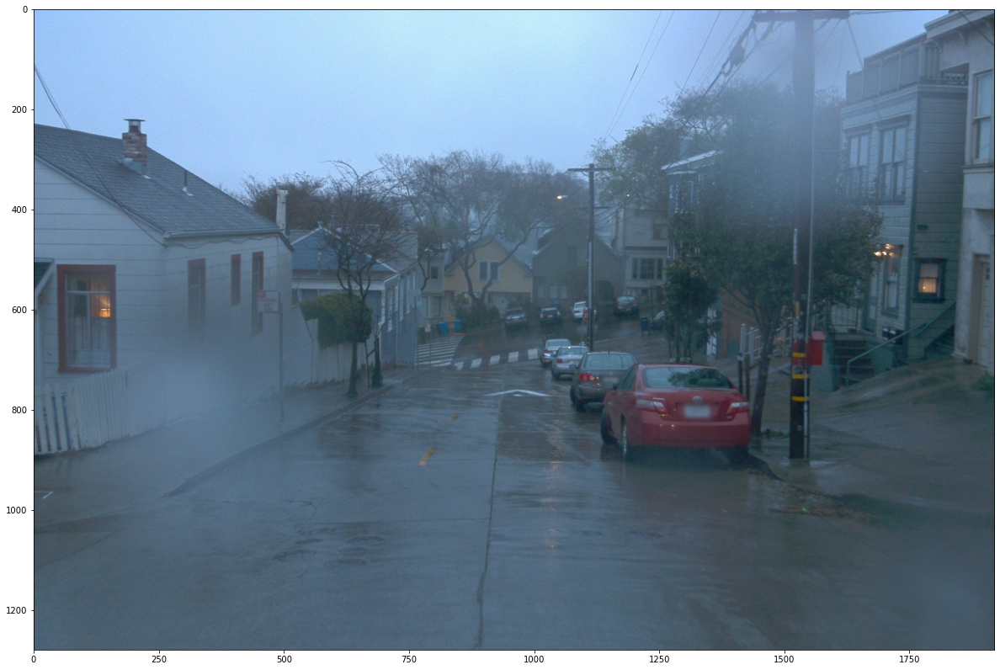

In [41]:
import numpy as np
import cv2
import os
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (25, 14)

Basepath=r'D:\\Dataset\\WaymoKittitraining_0000\\'
data_idx=150
filename="%06d.png" % (data_idx)
image_file = os.path.join(Basepath, 'image_0', filename)
calibration_file = os.path.join(Basepath, 'calib', filename.replace('png', 'txt'))
label_file = os.path.join(Basepath, 'label_0', filename.replace('png', 'txt'))
lidar_filename = os.path.join(Basepath, 'velodyne', filename.replace('png', 'bin'))

object3dlabel=utils.read_label(label_file)

pc_veloall=utils.load_velo_scan(lidar_filename, np.float32, 4)
pc_velo = pc_veloall[:, 0:4]

img = cv2.imread(image_file)
rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_height, img_width, img_channel = rgb.shape
plt.imshow(rgb)

print(data_idx, "image shape: ", rgb.shape)
print(data_idx, "velo  shape: ", pc_velo.shape)

In [42]:
object3dlabel[0].type

'Car'

In [43]:
box=object3dlabel[0]
data=[box.t[0], box.t[1], box.t[2], box.l, box.w, box.h, box.ry, box.type]#x, y,z

In [44]:
box.t[0]

2.44

In [45]:
data

[2.44, 1.3, -50.1, 6.14, 2.37, 3.2, -1.52, 'Car']

In [46]:
class WaymoCalibration(object):
    """ Calibration matrices and utils
        3d XYZ in <label>.txt are in rect camera coord.
        2d box xy are in image2 coord
        Points in <lidar>.bin are in Velodyne coord.

        y_image2 = P^2_rect * x_rect
        y_image2 = P^2_rect * R0_rect * Tr_velo_to_cam * x_velo
        x_ref = Tr_velo_to_cam * x_velo
        x_rect = R0_rect * x_ref

        P^2_rect = [f^2_u,  0,      c^2_u,  -f^2_u b^2_x;
                    0,      f^2_v,  c^2_v,  -f^2_v b^2_y;
                    0,      0,      1,      0]
                 = K * [1|t]

        image2 coord:
         ----> x-axis (u)
        |
        |
        v y-axis (v)

        velodyne coord:
        front x, left y, up z

        rect/ref camera coord:
        right x, down y, front z

        Ref (KITTI paper): http://www.cvlibs.net/publications/Geiger2013IJRR.pdf

        TODO(rqi): do matrix multiplication only once for each projection.
    """

    def __init__(self, calib_filepath):
        calibs = self.read_calib_file(calib_filepath)
        # Projection matrix from rect camera coord to image2 coord
        self.P = calibs["P0"]#["P2"]
        self.P = np.reshape(self.P, [3, 4])
        # Rigid transform from Velodyne coord to reference camera coord
        self.V2C = calibs["Tr_velo_to_cam_0"]#calibs["Tr_velo_to_cam"]
        self.V2C = np.reshape(self.V2C, [3, 4])
        self.C2V = self.inverse_rigid_trans(self.V2C)
        # Rotation from reference camera coord to rect camera coord
        self.R0 = calibs["R0_rect"]
        self.R0 = np.reshape(self.R0, [3, 3])

        # Camera intrinsics and extrinsics
        self.c_u = self.P[0, 2]
        self.c_v = self.P[1, 2]
        self.f_u = self.P[0, 0]
        self.f_v = self.P[1, 1]
        self.b_x = self.P[0, 3] / (-self.f_u)  # relative
        self.b_y = self.P[1, 3] / (-self.f_v)

    def inverse_rigid_trans(self,Tr):
        """ Inverse a rigid body transform matrix (3x4 as [R|t])
            [R'|-R't; 0|1]
        """
        inv_Tr = np.zeros_like(Tr)  # 3x4
        inv_Tr[0:3, 0:3] = np.transpose(Tr[0:3, 0:3])
        inv_Tr[0:3, 3] = np.dot(-np.transpose(Tr[0:3, 0:3]), Tr[0:3, 3])
        return inv_Tr

    def read_calib_file(self, filepath):
        """ Read in a calibration file and parse into a dictionary.
        Ref: https://github.com/utiasSTARS/pykitti/blob/master/pykitti/utils.py
        """
        data = {}
        with open(filepath, "r") as f:
            for line in f.readlines():
                line = line.rstrip()
                if len(line) == 0:
                    continue
                key, value = line.split(":", 1)
                # The only non-float values in these files are dates, which
                # we don't care about anyway
                try:
                    data[key] = np.array([float(x) for x in value.split()])
                except ValueError:
                    pass

        return data
    
    def project_rect_to_velo(self, pts_3d_rect):
        """ Input: nx3 points in rect camera coord.
            Output: nx3 points in velodyne coord.
        """
        pts_3d_ref = self.project_rect_to_ref(pts_3d_rect)
        return self.project_ref_to_velo(pts_3d_ref)
    
    def project_rect_to_ref(self, pts_3d_rect):
        """ Input and Output are nx3 points """
        return np.transpose(np.dot(np.linalg.inv(self.R0), np.transpose(pts_3d_rect)))
    
    def project_ref_to_velo(self, pts_3d_ref):
        pts_3d_ref = self.cart2hom(pts_3d_ref)  # nx4
        return np.dot(pts_3d_ref, np.transpose(self.C2V))
    
    def cart2hom(self, pts_3d):
        """ Input: nx3 points in Cartesian
            Oupput: nx4 points in Homogeneous by pending 1
        """
        n = pts_3d.shape[0]
        pts_3d_hom = np.hstack((pts_3d, np.ones((n, 1))))
        return pts_3d_hom

In [47]:
calib=WaymoCalibration(calibration_file)

In [48]:
calib.P

array([[2.059612e+03, 0.000000e+00, 9.524122e+02, 0.000000e+00],
       [0.000000e+00, 2.059612e+03, 6.345872e+02, 0.000000e+00],
       [0.000000e+00, 0.000000e+00, 1.000000e+00, 0.000000e+00]])

In [49]:
""" Takes an object and a projection matrix (P) and projects the 3d
    bounding box into the image plane.
    Returns:
        corners_2d: (8,2) array in left image coord.
        corners_3d: (8,3) array in in rect camera coord.
"""
_, box3d_pts_3d = utils.compute_box_3d(box, calib.P)

In [50]:
box3d_pts_3d

array([[  1.41240615,   1.3       , -46.97379209],
       [  3.77934919,   1.3       , -47.09412762],
       [  3.46759385,   1.3       , -53.22620791],
       [  1.10065081,   1.3       , -53.10587238],
       [  1.41240615,  -1.9       , -46.97379209],
       [  3.77934919,  -1.9       , -47.09412762],
       [  3.46759385,  -1.9       , -53.22620791],
       [  1.10065081,  -1.9       , -53.10587238]])

In [51]:
box3d_pts_3d_velo = calib.project_rect_to_velo(box3d_pts_3d)

In [52]:
box3d_pts_3d_velo

array([[-45.44555374,  -1.307038  ,   1.10889334],
       [-45.57332379,  -3.67319983,   1.15193948],
       [-51.70429268,  -3.34160043,   1.18129433],
       [-51.57652263,  -0.9754386 ,   1.13824819],
       [-45.42714065,  -1.24982693,   4.30832886],
       [-45.5549107 ,  -3.61598876,   4.351375  ],
       [-51.68587958,  -3.28438936,   4.38072985],
       [-51.55810953,  -0.91822753,   4.33768371]])

In [54]:
import Kitti.viz_util as vizutils

import mayavi.mlab as mlab
# import sys
fig = mlab.figure(
    figure=None, bgcolor=(0, 0, 0), fgcolor=None, engine=None, size=(1000, 500)
)
# if "mlab" not in sys.modules:
#     import mayavi.mlab as mlab
vizutils.draw_lidar(pc_velo, fig=fig, pc_label=False)

color = (0, 1, 0)
for obj in object3dlabel:
    if obj.type == "DontCare":
        continue
    # Draw 3d bounding box
    _, box3d_pts_3d = utils.compute_box_3d(obj, calib.P)
    box3d_pts_3d_velo = calib.project_rect_to_velo(box3d_pts_3d)
    print("box3d_pts_3d_velo:")
    print(box3d_pts_3d_velo)
    #draw_gt_boxes3d([box3d_pts_3d_velo], fig=fig, color=color)
    vizutils.draw_gt_boxes3d([box3d_pts_3d_velo], fig=fig, color=color, label=obj.type)


mlab.show()

==================== (157152, 4)
box3d_pts_3d_velo:
[[-45.44555374  -1.307038     1.10889334]
 [-45.57332379  -3.67319983   1.15193948]
 [-51.70429268  -3.34160043   1.18129433]
 [-51.57652263  -0.9754386    1.13824819]
 [-45.42714065  -1.24982693   4.30832886]
 [-45.5549107   -3.61598876   4.351375  ]
 [-51.68587958  -3.28438936   4.38072985]
 [-51.55810953  -0.91822753   4.33768371]]
box3d_pts_3d_velo:
[[-34.04256851  -1.41203891   0.84511024]
 [-34.05040589  -3.40170459   0.88073379]
 [-38.67029353  -3.38303658   0.90698793]
 [-38.66245615  -1.3933709    0.87136438]
 [-34.02916147  -1.3703821    3.17469923]
 [-34.03699885  -3.36004778   3.21032278]
 [-38.6568865   -3.34137977   3.23657691]
 [-38.64904912  -1.35171409   3.20095336]]
box3d_pts_3d_velo:
[[58.73022442 -1.6813804  -0.58414968]
 [58.74246846 -3.70102167 -0.54810569]
 [54.18262776 -3.72818861 -0.52137753]
 [54.17038372 -1.70854733 -0.55742152]
 [58.74040916 -1.64973552  1.18553809]
 [58.7526532  -3.6693768   1.22158208]
 [

# Open3D

In [55]:
obj

In [ ]:
box=object3dlabel[0]
data=[box.t[0], box.t[1], box.t[2], box.l, box.w, box.h, box.ry, box.type]#x, y,z

In [59]:
def convert_bounding_box_to_points(cx,cy,cz,length,width,height,heading):
    """
    # https://github.com/waymo-research/waymo-open-dataset/issues/108
    """
#     heading = -box.heading
#     cx = box.center_x
#     cy = box.center_y
#     cz = box.center_z
#     length = box.length
#     width = box.width
#     height = box.height

    corner = np.array([[-0.5 * length, -0.5 * width],
                       [-0.5 * length, 0.5 * width],
                       [0.5 * length, -0.5 * width],
                       [0.5 * length, 0.5 * width]])

    rotation_matrix = np.array([[np.cos(heading), - np.sin(heading)],
                                [np.sin(heading), np.cos(heading)]])

    corner = np.matmul(corner, rotation_matrix)

    z_bottom = cz - height / 2
    z_top = cz + height / 2
    p0 = [cx + corner[0][0], cy + corner[0][1], z_bottom]
    p1 = [cx + corner[1][0], cy + corner[1][1], z_bottom]
    p2 = [cx + corner[2][0], cy + corner[2][1], z_bottom]
    p3 = [cx + corner[3][0], cy + corner[3][1], z_bottom]
    p4 = [cx + corner[0][0], cy + corner[0][1], z_top]
    p5 = [cx + corner[1][0], cy + corner[1][1], z_top]
    p6 = [cx + corner[2][0], cy + corner[2][1], z_top]
    p7 = [cx + corner[3][0], cy + corner[3][1], z_top]
    return np.array([p0, p1, p2, p3, p4, p5, p6, p7])

In [61]:
import open3d as o3d
import datetime

vis = o3d.visualization.VisualizerWithKeyCallback()
vis.create_window(width=1080, height=720)
pcd = o3d.geometry.PointCloud()
points = pc_velo[:, :3]#115384, 3
pcd.points = o3d.utility.Vector3dVector(points)
vis.add_geometry(pcd)

# * Add the bounding box geometry here
for obj in object3dlabel:
    points = convert_bounding_box_to_points(obj.t[0], obj.t[1], obj.t[2], obj.l, obj.w, obj.h, obj.ry)
    bounding_box = o3d.geometry.OrientedBoundingBox(
    ).create_from_points(o3d.utility.Vector3dVector(points))
    vis.add_geometry(bounding_box)

# Start the render loop here
start = datetime.datetime.now()
while True:
    vis.poll_events()
    vis.update_renderer()
    current = datetime.datetime.now()
    if (current - start) > datetime.timedelta(seconds=10.0):
        break

In [18]:
from Kitti.myKitti_object_vis import kitti_object

In [19]:

%matplotlib inline
import matplotlib.pyplot as plt
import cv2
from Kitti.myKitti_object_vis import kitti_object, show_lidar_with_depth, show_lidar_on_image, \
                         show_image_with_boxes, show_lidar_topview_with_boxes

In [64]:
!dir D:\Dataset\WaymoKittitraining_0000\

 Volume in drive D is DATA
 Volume Serial Number is 80C6-B311

 Directory of D:\Dataset\WaymoKittitraining_0000

03/14/2021  03:16 AM    <DIR>          .
03/14/2021  03:16 AM    <DIR>          ..
03/14/2021  01:10 AM    <DIR>          calib
03/14/2021  01:36 AM    <DIR>          image_0
03/14/2021  02:02 AM    <DIR>          image_1
03/14/2021  02:28 AM    <DIR>          image_2
03/14/2021  02:47 AM    <DIR>          image_3
03/14/2021  03:06 AM    <DIR>          image_4
03/14/2021  03:09 AM    <DIR>          label_0
03/14/2021  03:09 AM    <DIR>          label_1
03/14/2021  03:09 AM    <DIR>          label_2
03/14/2021  03:09 AM    <DIR>          label_3
03/14/2021  03:09 AM    <DIR>          label_4
03/14/2021  03:13 AM    <DIR>          label_all
03/14/2021  03:16 AM    <DIR>          pose
03/14/2021  03:38 AM    <DIR>          velodyne
               0 File(s)              0 bytes
              16 Dir(s)  1,884,425,269,248 bytes free


In [29]:
import glob
file_count =  glob.glob(r'D:\\Dataset\\WaymoKittitraining_0000\\'+'*image_0\\*.png')
len(file_count)

4761

In [57]:
file_count =  glob.glob(r'D:\\Dataset\\WaymoKittitraining_0000\\'+'*label_1\\*.txt')
len(file_count)

0

In [65]:
file_count =  glob.glob(r'D:\\Dataset\\WaymoKittitraining_0000\\'+'*label_all\\*.txt')
len(file_count)

4761

In [55]:
import importlib 
from Waymo import WaymoKitti_object_vis
importlib.reload(WaymoKitti_object_vis)

<module 'Waymo.WaymoKitti_object_vis' from 'C:\\Users\\lkk\\Documents\\Developer\\3DDepth\\Waymo\\WaymoKitti_object_vis.py'>

In [56]:
dataset = WaymoKitti_object_vis.Waymokitti_object(r'D:\\Dataset\\','WaymoKittitraining_0000')
len(dataset)

D:\\Dataset\\ WaymoKittitraining_0000
Camera:0 image files: 4761
Camera:1 image files: 4761
Camera:2 image files: 4761
Camera:3 image files: 4761
Camera:4 image files: 4761
Camera:0 label files: 4761
Camera:1 label files: 0
Camera:2 label files: 0
Camera:3 label files: 0
Camera:4 label files: 0
Calibration files: 4761
Lidar files: 0


0

In [27]:
dataset = kitti_object(r'D:\\Dataset\\WaymoKittitraining_0000\\')
len(dataset)

D:\\Dataset\\WaymoKittitraining_0000\\ training


7481

In [12]:
dataset = kitti_object('D:\Dataset\WaymoKittitraining_0000', '')

data_idx = 0
objects = dataset.get_label_objects(data_idx)
pc_velo = dataset.get_lidar(data_idx)
calib = dataset.get_calibration(data_idx)
img = dataset.get_image(data_idx)
img_height, img_width, _ = img.shape


/mnt/DATA5T/Share/Dataset/Kitti/object training
/mnt/DATA5T/Share/Dataset/Kitti/object/training/velodyne/000000.bin


In [31]:
pc_velo.shape

(115384, 4)

In [ ]:
#Does not work in jupyter lab
fig_3d = mlab.figure(bgcolor=(0, 0, 0), size=(800, 450))
show_lidar_with_depth(pc_velo, objects, calib, fig_3d, True, img_width, img_height)
fig_3d

run this code in command line inside the kitti_object_vis to show the lidar and image ground truth results: (Newenv) kaikai@kaikai-i9new:~/Documents/PyCharmremote/PseudoLidar/kitti_object_vis$ python kitti_object.py --show_lidar_with_depth --img_fov --const_box --vis --show_image_with_boxes -d /mnt/DATA5T/Share/Dataset/Kitti/object/

Specifiy the id: (Newenv) kaikai@kaikai-i9new:~/Documents/PyCharmremote/PseudoLidar/kitti_object_vis$ python kitti_object.py --show_lidar_with_depth --img_fov --const_box --vis --show_image_with_boxes -d /mnt/DATA5T/Share/Dataset/Kitti/object/ --ind 10


![alt text](figs/kittidata1.png "Kitti Data Visualization")

![alt text](figs/kittidata1.png "Kitti Data Visualization")

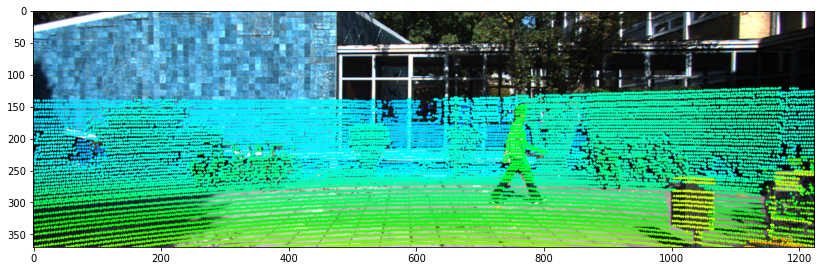

In [13]:
img_lidar = show_lidar_on_image(pc_velo[:, :3], img, calib, img_width, img_height)
img_lidar = cv2.cvtColor(img_lidar, cv2.COLOR_BGR2RGB)

fig_lidar = plt.figure(figsize=(14, 7))
ax_lidar = fig_lidar.subplots()
ax_lidar.imshow(img_lidar)
plt.show()

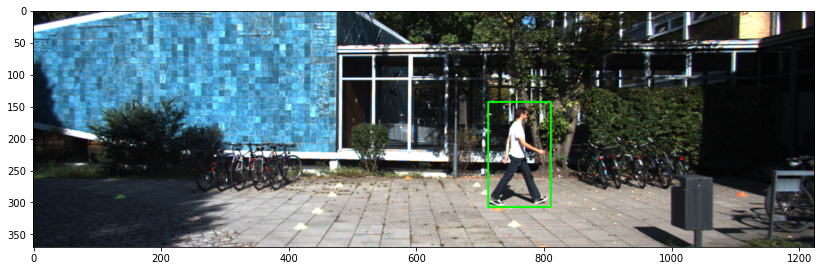

In [14]:
img_bbox2d, img_bbox3d = show_image_with_boxes(img, objects, calib)
img_bbox2d = cv2.cvtColor(img_bbox2d, cv2.COLOR_BGR2RGB)

fig_bbox2d = plt.figure(figsize=(14, 7))
ax_bbox2d = fig_bbox2d.subplots()
ax_bbox2d.imshow(img_bbox2d)
plt.show()

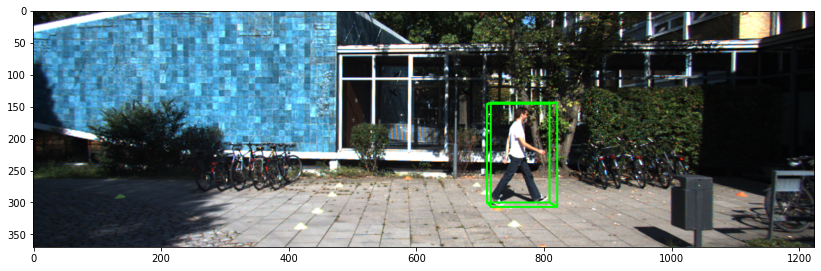

In [15]:
img_bbox3d = cv2.cvtColor(img_bbox3d, cv2.COLOR_BGR2RGB)

fig_bbox3d = plt.figure(figsize=(14, 7))
ax_bbox3d = fig_bbox3d.subplots()
ax_bbox3d.imshow(img_bbox3d)
plt.show()

top_image: (500, 300, 3)


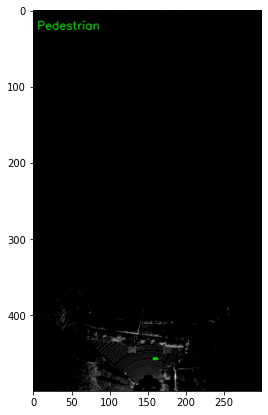

In [16]:
img_bev = show_lidar_topview_with_boxes(pc_velo, objects, calib)

fig_bev = plt.figure(figsize=(14, 7))
ax_bev = fig_bev.subplots()
ax_bev.imshow(img_bev)
plt.show()

# Check Waymo Kitti format data

In [66]:
import pandas as pd

def read_label_3d(label_file):
    """Read and parse label information of kitti 3d object detection dataset.
  
    :param label_file: filname like kitti_3d/{training,testing}/label_2/id.txt
    Returns Pandas DataFrame
    Data Format Description
    =======================
    The data for training and testing can be found in the corresponding folders.
    The sub-folders are structured as follows:
      - image_02/ contains the left color camera images (png)
      - label_02/ contains the left color camera label files (plain text files)
      - calib/ contains the calibration for all four cameras (plain text file)
    The label files contain the following information, which can be read and
    written using the matlab tools (readLabels.m, writeLabels.m) provided within
    this devkit. All values (numerical or strings) are separated via spaces,
    each row corresponds to one object. The 15 columns represent:
    #Values    Name      Description
    ----------------------------------------------------------------------------
       1    type         Describes the type of object: 'Car', 'Van', 'Truck',
                         'Pedestrian', 'Person_sitting', 'Cyclist', 'Tram',
                         'Misc' or 'DontCare'
       1    truncated    Float from 0 (non-truncated) to 1 (truncated), where
                         truncated refers to the object leaving image boundaries
       1    occluded     Integer (0,1,2,3) indicating occlusion state:
                         0 = fully visible, 1 = partly occluded
                         2 = largely occluded, 3 = unknown
       1    alpha        Observation angle of object, ranging [-pi..pi]
       4    bbox         2D bounding box of object in the image (0-based index):
                         contains left, top, right, bottom pixel coordinates
       3    dimensions   3D object dimensions: height, width, length (in meters)
       3    location     3D object location x,y,z in camera coordinates (in meters)
       1    rotation_y   Rotation ry around Y-axis in camera coordinates [-pi..pi]
       1    score        Only for results: Float, indicating confidence in
                         detection, needed for p/r curves, higher is better.
    """
    return pd.read_csv(label_file, sep=" ", names=['label', 'truncated', 'occluded', 'alpha', 'bbox_xmin', 'bbox_ymin', 'bbox_xmax', 'bbox_ymax', 'dim_height', 'dim_width', 'dim_length', 'loc_x', 'loc_y', 'loc_z', 'rotation_y', 'score'])

In [68]:
labelpath=r'D:\\Dataset\\WaymoKittitraining_0000\\label_0\\000010.txt'
label_pd=read_label_3d(labelpath)
label_pd

,label,truncated,occluded,alpha,bbox_xmin,bbox_ymin,bbox_xmax,bbox_ymax,dim_height,dim_width,dim_length,loc_x,loc_y,loc_z,rotation_y,score
0,Car,0,0,-10,0,0,0,0,3.20,2.37,6.14,3.92,0.20,24.44,-1.30,NaN
1,Car,0,0,-10,0,0,0,0,2.33,1.99,4.62,6.57,-0.44,36.21,-1.35,NaN
2,Car,0,0,-10,0,0,0,0,2.13,2.39,5.78,-12.02,1.85,12.51,0.17,NaN
3,Car,0,0,-10,0,0,0,0,1.96,2.08,4.73,-22.58,1.45,22.07,-2.89,NaN
4,Car,0,0,-10,0,0,0,0,2.10,1.83,3.90,-14.16,1.47,-51.09,-2.78,NaN
5,Car,0,0,-10,0,0,0,0,2.14,2.25,4.40,11.20,-0.69,30.14,0.21,NaN
6,Car,0,0,-10,0,0,0,0,1.69,2.25,4.42,5.55,1.29,13.60,0.23,NaN
7,Car,0,0,-10,0,0,0,0,2.22,2.03,3.77,10.77,-1.64,54.64,-1.32,NaN
8,Car,0,0,-10,0,0,0,0,1.73,2.11,4.38,-14.53,1.01,20.37,-2.90,NaN


In [54]:
!cat '/mnt/DATA5T/Share/Dataset/Kitti/object/training/label_2/000007.txt'

Car 0.00 0 -1.56 564.62 174.59 616.43 224.74 1.61 1.66 3.20 -0.69 1.69 25.01 -1.59
Car 0.00 0 1.71 481.59 180.09 512.55 202.42 1.40 1.51 3.70 -7.43 1.88 47.55 1.55
Car 0.00 0 1.64 542.05 175.55 565.27 193.79 1.46 1.66 4.05 -4.71 1.71 60.52 1.56
Cyclist 0.00 0 1.89 330.60 176.09 355.61 213.60 1.72 0.50 1.95 -12.63 1.88 34.09 1.54
DontCare -1 -1 -10 753.33 164.32 798.00 186.74 -1 -1 -1 -1000 -1000 -1000 -10
DontCare -1 -1 -10 738.50 171.32 753.27 184.42 -1 -1 -1 -1000 -1000 -1000 -10


In [55]:
!ls /mnt/DATA5T/Share/Dataset/Kitti/object/training/

calib	   disparity  image_3  planes  velodyne
depth_map  image_2    label_2  prev_2


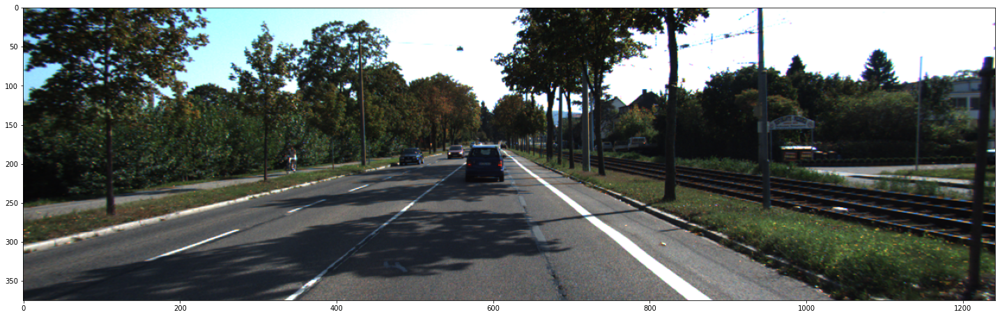

In [113]:
import cv2
import os
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (25, 14)

Basepath='/mnt/DATA5T/Share/Dataset/Kitti/object/training'
filename='000007.png'
image_file = path = os.path.join(Basepath, 'image_2', filename)
calibration_file = os.path.join(Basepath, 'calib', filename.replace('png', 'txt'))
label_file = os.path.join(Basepath, 'label_2', filename.replace('png', 'txt'))
labels = read_label_3d(label_file)
img = cv2.imread(image_file)

rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_height, img_width, img_channel = rgb.shape
plt.imshow(rgb)

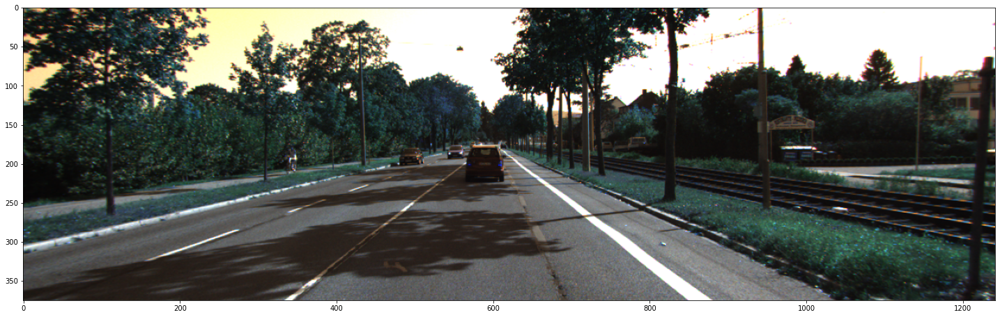

In [114]:
plt.imshow(img)#color not correct

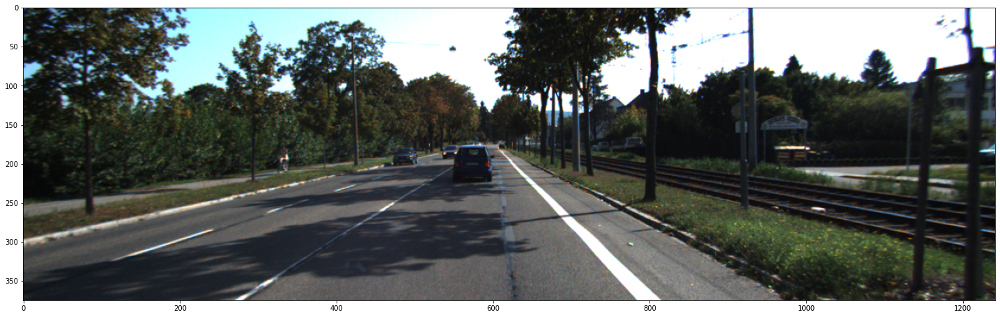

In [164]:
img3_path=image_file.replace('image_2', 'image_3')
img3 = cv2.imread(img3_path)
rgb2 = cv2.cvtColor(img3, cv2.COLOR_BGR2RGB)
plt.imshow(rgb2)

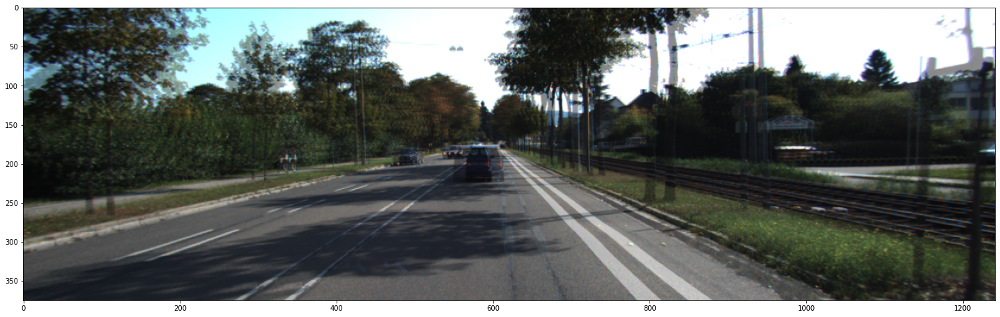

In [162]:
combined = cv2.addWeighted(rgb,0.5,rgb2,0.5,0)
plt.imshow(combined)

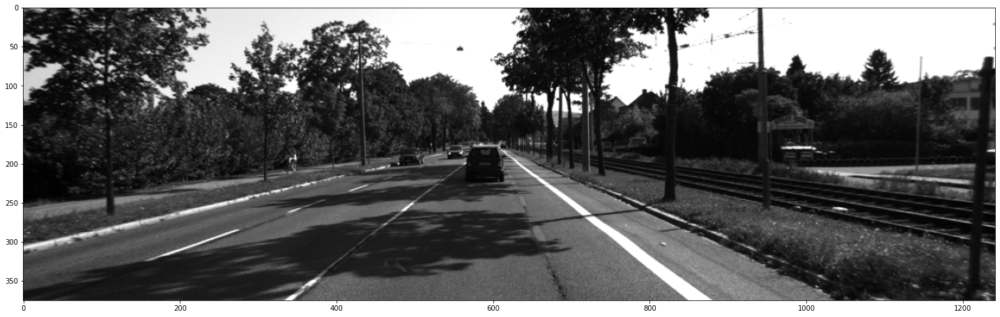

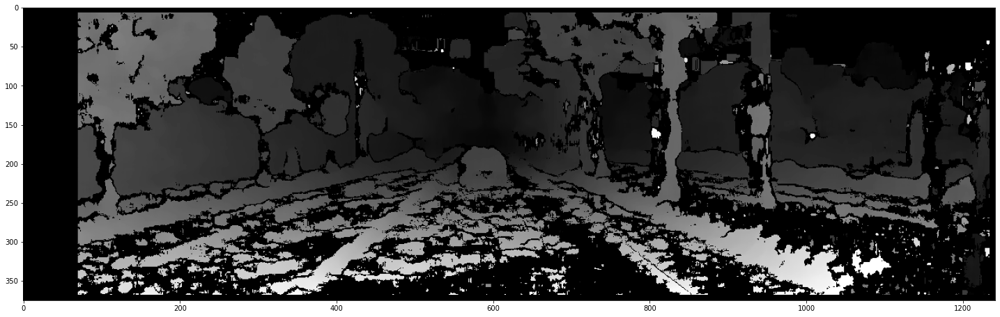

In [165]:
imgL = cv2.imread(image_file,0)#load an image as a single channel grayscale 
imgR = cv2.imread(img3_path,0)
plt.imshow(imgL,'gray')
plt.show()

stereo = cv2.StereoBM_create(numDisparities=64, blockSize=15)
disparity = stereo.compute(imgL,imgR)
plt.imshow(disparity,'gray')
plt.show()

In [117]:
%cat $label_file

Car 0.00 0 -1.56 564.62 174.59 616.43 224.74 1.61 1.66 3.20 -0.69 1.69 25.01 -1.59
Car 0.00 0 1.71 481.59 180.09 512.55 202.42 1.40 1.51 3.70 -7.43 1.88 47.55 1.55
Car 0.00 0 1.64 542.05 175.55 565.27 193.79 1.46 1.66 4.05 -4.71 1.71 60.52 1.56
Cyclist 0.00 0 1.89 330.60 176.09 355.61 213.60 1.72 0.50 1.95 -12.63 1.88 34.09 1.54
DontCare -1 -1 -10 753.33 164.32 798.00 186.74 -1 -1 -1 -1000 -1000 -1000 -10
DontCare -1 -1 -10 738.50 171.32 753.27 184.42 -1 -1 -1 -1000 -1000 -1000 -10


In [118]:
labels

,label,truncated,occluded,alpha,bbox_xmin,bbox_ymin,bbox_xmax,bbox_ymax,dim_height,dim_width,dim_length,loc_x,loc_y,loc_z,rotation_y,score
0,Car,0.0,0,-1.56,564.62,174.59,616.43,224.74,1.61,1.66,3.20,-0.69,1.69,25.01,-1.59,NaN
1,Car,0.0,0,1.71,481.59,180.09,512.55,202.42,1.40,1.51,3.70,-7.43,1.88,47.55,1.55,NaN
2,Car,0.0,0,1.64,542.05,175.55,565.27,193.79,1.46,1.66,4.05,-4.71,1.71,60.52,1.56,NaN
3,Cyclist,0.0,0,1.89,330.60,176.09,355.61,213.60,1.72,0.50,1.95,-12.63,1.88,34.09,1.54,NaN
4,DontCare,-1.0,-1,-10.00,753.33,164.32,798.00,186.74,-1.00,-1.00,-1.00,-1000.00,-1000.00,-1000.00,-10.00,NaN
5,DontCare,-1.0,-1,-10.00,738.50,171.32,753.27,184.42,-1.00,-1.00,-1.00,-1000.00,-1000.00,-1000.00,-10.00,NaN


In [119]:
from tabulate import tabulate
print(tabulate(labels, headers='keys'))

    label       truncated    occluded    alpha    bbox_xmin    bbox_ymin    bbox_xmax    bbox_ymax    dim_height    dim_width    dim_length     loc_x     loc_y     loc_z    rotation_y    score
--  --------  -----------  ----------  -------  -----------  -----------  -----------  -----------  ------------  -----------  ------------  --------  --------  --------  ------------  -------
 0  Car                 0           0    -1.56       564.62       174.59       616.43       224.74          1.61         1.66          3.2      -0.69      1.69     25.01         -1.59      nan
 1  Car                 0           0     1.71       481.59       180.09       512.55       202.42          1.4          1.51          3.7      -7.43      1.88     47.55          1.55      nan
 2  Car                 0           0     1.64       542.05       175.55       565.27       193.79          1.46         1.66          4.05     -4.71      1.71     60.52          1.56      nan
 3  Cyclist             0          

In [120]:
#2D Labels
coordinates = labels[[col for col in labels.columns if col.startswith('bbox')]].astype(int)
coordinates

,bbox_xmin,bbox_ymin,bbox_xmax,bbox_ymax
0,564,174,616,224
1,481,180,512,202
2,542,175,565,193
3,330,176,355,213
4,753,164,798,186
5,738,171,753,184


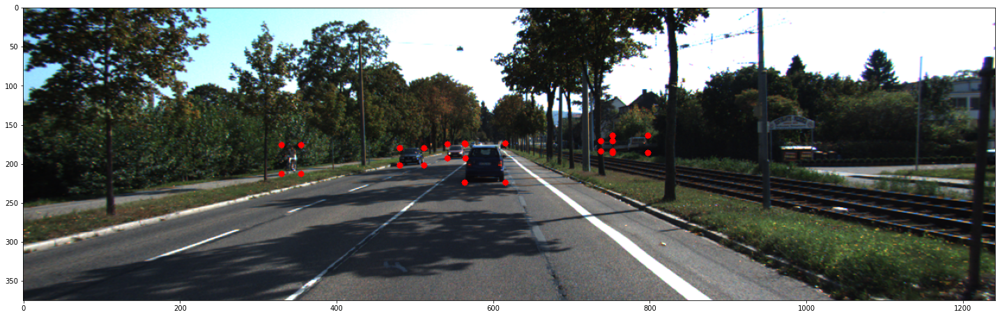

In [121]:
img=np.copy(rgb)
import numpy as np
corners = coordinates.apply(lambda x: ((x.bbox_xmin, x.bbox_ymin), (x.bbox_xmin, x.bbox_ymax), \
(x.bbox_xmax, x.bbox_ymin), (x.bbox_xmax, x.bbox_ymax)), axis=1)
for box in corners:
    for corner in box:
        cv2.circle(img, corner, 1, (255, 0, 0), 5)
        # cv.Circle(img, center, radius, color, thickness=1, lineType=8, shift=0)

plt.imshow(img)

In [122]:
labels[['label'] + [col for col in labels.columns if col.startswith('bbox')]]

,label,bbox_xmin,bbox_ymin,bbox_xmax,bbox_ymax
0,Car,564.62,174.59,616.43,224.74
1,Car,481.59,180.09,512.55,202.42
2,Car,542.05,175.55,565.27,193.79
3,Cyclist,330.60,176.09,355.61,213.60
4,DontCare,753.33,164.32,798.00,186.74
5,DontCare,738.50,171.32,753.27,184.42


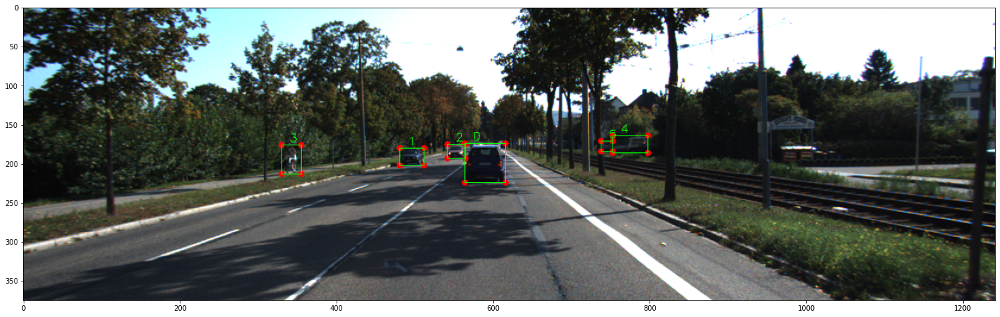

In [123]:
#Draw 2D boxes
boxes = labels.apply(lambda x: ((int(x.bbox_xmin), int(x.bbox_ymin)), (int(x.bbox_xmax), int(x.bbox_ymax))), axis=1)
for i, box in enumerate(boxes):
    img = cv2.rectangle(img, box[0], box[1], (0, 255, 0))
    img = cv2.putText(img, str(i), (box[0][0] + 10, box[0][1] - 4) , cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,255,0), 1)

plt.imshow(img)

In [94]:
!pwd

/home/kaikai/Documents/PyCharmremote/PseudoLidar


In [68]:
%cd ..
!pwd

/home/kaikai/Documents/PyCharmremote/PseudoLidar
/home/kaikai/Documents/PyCharmremote/PseudoLidar


In [72]:
import os

import matplotlib.pyplot as plt
import numpy as np
import os
import sys
module_path = os.path.abspath(os.path.join('.'))
if module_path not in sys.path:
    sys.path.append(module_path)

In [78]:
sys.path

['/home/kaikai/Documents/PyCharmremote/PseudoLidar',
 '/home/kaikai/anaconda3/envs/Newenv/lib/python37.zip',
 '/home/kaikai/anaconda3/envs/Newenv/lib/python3.7',
 '/home/kaikai/anaconda3/envs/Newenv/lib/python3.7/lib-dynload',
 '',
 '/home/kaikai/.local/lib/python3.7/site-packages',
 '/home/kaikai/anaconda3/envs/Newenv/lib/python3.7/site-packages',
 '/home/kaikai/Documents/PyCharmremote/PseudoLidar/argoverse-api',
 '/home/kaikai/anaconda3/envs/Newenv/lib/python3.7/site-packages/IPython/extensions',
 '/home/kaikai/.ipython',
 '/home/kaikai/Documents/PyCharmremote/PseudoLidar/mayavi']

In [82]:
from kittiutils import *

In [124]:
calibration_file

'/mnt/DATA5T/Share/Dataset/Kitti/object/training/calib/000007.txt'

In [125]:
# Load calibration
calib = read_calib_file(calibration_file)#function in kittiutils.py
calib

{'P0': array([721.5377,   0.    , 609.5593,   0.    ,   0.    , 721.5377,
        172.854 ,   0.    ,   0.    ,   0.    ,   1.    ,   0.    ]),
 'P1': array([ 721.5377,    0.    ,  609.5593, -387.5744,    0.    ,  721.5377,
         172.854 ,    0.    ,    0.    ,    0.    ,    1.    ,    0.    ]),
 'P2': array([7.215377e+02, 0.000000e+00, 6.095593e+02, 4.485728e+01,
        0.000000e+00, 7.215377e+02, 1.728540e+02, 2.163791e-01,
        0.000000e+00, 0.000000e+00, 1.000000e+00, 2.745884e-03]),
 'P3': array([ 7.215377e+02,  0.000000e+00,  6.095593e+02, -3.395242e+02,
         0.000000e+00,  7.215377e+02,  1.728540e+02,  2.199936e+00,
         0.000000e+00,  0.000000e+00,  1.000000e+00,  2.729905e-03]),
 'R0_rect': array([ 0.9999239 ,  0.00983776, -0.00744505, -0.0098698 ,  0.9999421 ,
        -0.00427846,  0.00740253,  0.00435161,  0.9999631 ]),
 'Tr_velo_to_cam': array([ 7.533745e-03, -9.999714e-01, -6.166020e-04, -4.069766e-03,
         1.480249e-02,  7.280733e-04, -9.998902e-01, -7.

In [126]:
label_file

'/mnt/DATA5T/Share/Dataset/Kitti/object/training/label_2/000007.txt'

In [127]:
# Load labels
labels = load_label(label_file)
labels #Box3D object 

In [128]:
labels[0].box2d

array([564.62, 174.59, 616.43, 224.74])

In [129]:
points_3d=labels[0].in_camera_coordinate()
points_3d #(3, 8)=xyz, 8 points for a cubic 

array([[-1.55057095,  0.10912297,  0.17057095, -1.48912297, -1.55057095,
         0.10912297,  0.17057095, -1.48912297],
       [ 1.69      ,  1.69      ,  1.69      ,  1.69      ,  0.08      ,
         0.08      ,  0.08      ,  0.08      ],
       [26.59376692, 26.62564305, 23.42623308, 23.39435695, 26.59376692,
        26.62564305, 23.42623308, 23.39435695]])

In [130]:
points_3d.shape

(3, 8)

In [131]:
# projection matrix
P_rect2cam2 = calib['P2']
P_rect2cam2

array([7.215377e+02, 0.000000e+00, 6.095593e+02, 4.485728e+01,
       0.000000e+00, 7.215377e+02, 1.728540e+02, 2.163791e-01,
       0.000000e+00, 0.000000e+00, 1.000000e+00, 2.745884e-03])

In [132]:
P_rect2cam2=P_rect2cam2.reshape((3, 4))
P_rect2cam2

array([[7.215377e+02, 0.000000e+00, 6.095593e+02, 4.485728e+01],
       [0.000000e+00, 7.215377e+02, 1.728540e+02, 2.163791e-01],
       [0.000000e+00, 0.000000e+00, 1.000000e+00, 2.745884e-03]])

In [133]:
#box3d_pixelcoord = map_box_to_image(labels[0], P_rect2cam2)#Same to the following code
#box3d_pixelcoord
#re: https://github.com/darylclimb/cvml_project/blob/master/projections/lidar_camera_projection/lidar_camera_project.py
# project the 3d bounding box into the image plane
box3d_pixelcoord = project_to_image(points_3d, P_rect2cam2)
box3d_pixelcoord

array([[569.11746074, 614.13786611, 616.65550643, 565.48226744,
        569.11746074, 614.13786611, 616.65550643, 565.48226744],
       [218.69235724, 218.63748536, 224.88957768, 224.96047078,
        175.0146125 , 175.01202609, 175.3067214 , 175.31006298]])

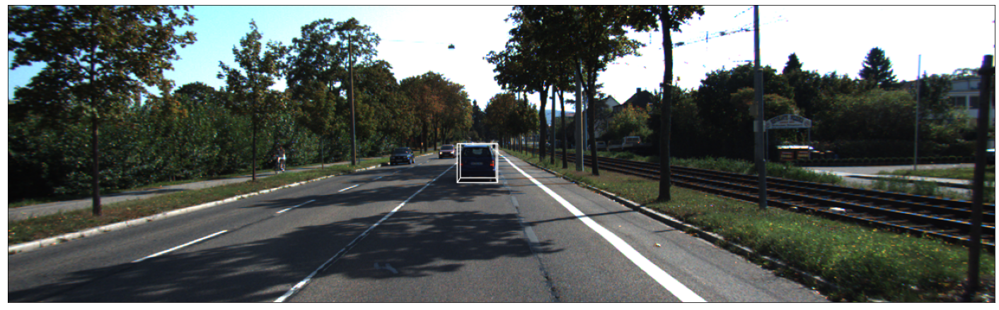

In [134]:
img_3dbox = np.copy(rgb)
img_3dbox = draw_projected_box3d(img_3dbox, box3d_pixelcoord)
plt.imshow(img_3dbox)
plt.yticks([])
plt.xticks([])
plt.show()

In [104]:
lidar_file = os.path.join(Basepath, 'velodyne', filename.replace('png', 'bin'))
lidar_file

'/mnt/DATA5T/Share/Dataset/Kitti/object/training/velodyne/000007.bin'

In [105]:
# Load Lidar PC
pc_velo = load_velo_scan(lidar_file)

In [106]:
pc_velo.shape 

(122798, 4)

In [107]:
pc_velo_xyz=pc_velo[:, :3]#only take xyz

In [135]:
P_velo2cam_ref=calib['Tr_velo_to_cam'].reshape(3, 4)
P_velo2cam_ref

array([[ 7.533745e-03, -9.999714e-01, -6.166020e-04, -4.069766e-03],
       [ 1.480249e-02,  7.280733e-04, -9.998902e-01, -7.631618e-02],
       [ 9.998621e-01,  7.523790e-03,  1.480755e-02, -2.717806e-01]])

In [136]:
P_velo2cam_ref = np.vstack((P_velo2cam_ref, np.array([0., 0., 0., 1.])))  # velo2ref_cam
P_velo2cam_ref

array([[ 7.533745e-03, -9.999714e-01, -6.166020e-04, -4.069766e-03],
       [ 1.480249e-02,  7.280733e-04, -9.998902e-01, -7.631618e-02],
       [ 9.998621e-01,  7.523790e-03,  1.480755e-02, -2.717806e-01],
       [ 0.000000e+00,  0.000000e+00,  0.000000e+00,  1.000000e+00]])

In [137]:
R_ref2rect = np.eye(4)
R_ref2rect

array([[1., 0., 0., 0.],
       [0., 1., 0., 0.],
       [0., 0., 1., 0.],
       [0., 0., 0., 1.]])

In [138]:
R0_rect = calib['R0_rect'].reshape(3, 3)  # ref_cam2rect
R0_rect

array([[ 0.9999239 ,  0.00983776, -0.00744505],
       [-0.0098698 ,  0.9999421 , -0.00427846],
       [ 0.00740253,  0.00435161,  0.9999631 ]])

In [139]:
R_ref2rect[:3, :3] = R0_rect
R_ref2rect

array([[ 0.9999239 ,  0.00983776, -0.00744505,  0.        ],
       [-0.0098698 ,  0.9999421 , -0.00427846,  0.        ],
       [ 0.00740253,  0.00435161,  0.9999631 ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  1.        ]])

In [140]:
P_rect2cam2 = calib['P2'].reshape((3, 4))
P_rect2cam2

array([[7.215377e+02, 0.000000e+00, 6.095593e+02, 4.485728e+01],
       [0.000000e+00, 7.215377e+02, 1.728540e+02, 2.163791e-01],
       [0.000000e+00, 0.000000e+00, 1.000000e+00, 2.745884e-03]])

In [142]:
proj_velo2cam2 = P_rect2cam2 @ R_ref2rect @ P_velo2cam_ref #Projection from lidar to camera 2
proj_velo2cam2 #ref: def project_velo_to_cam2(calib)

array([[ 6.09695409e+02, -7.21421597e+02, -1.25125855e+00,
        -1.23041806e+02],
       [ 1.80384202e+02,  7.64479802e+00, -7.19651474e+02,
        -1.01016688e+02],
       [ 9.99945389e-01,  1.24365378e-04,  1.04513030e-02,
        -2.69386912e-01]])

In [143]:
# apply projection from lidar to image2
pts_2d = project_to_image(pc_velo_xyz.transpose(), proj_velo2cam2)
pts_2d

array([[516.96145521, 514.65414547, 513.49728621, ..., 919.57635492,
        916.78969211, 915.33207593],
       [153.97368802, 153.96311038, 153.95080681, ..., 527.34871444,
        527.02448556, 526.91997808]])

In [144]:
pts_2d.shape

(2, 122798)

In [145]:
# Filter lidar points to be within image FOV
inds = np.where((pts_2d[0, :] < img_width) & (pts_2d[0, :] >= 0) &
                (pts_2d[1, :] < img_height) & (pts_2d[1, :] >= 0) &
                (pc_velo[:, 0] > 0)
                )
inds

(array([    0,     1,     2, ..., 92771, 92772, 92773]),)

In [146]:
# Filter out pixels points
imgfov_pc_pixel = pts_2d[:, inds[0]]

In [158]:
imgfov_pc_pixel.shape

(2, 19423)

In [152]:
# Retrieve depth from lidar
imgfov_pc_velo = pc_velo_xyz[inds[0], :]#get data from the original lidar points
imgfov_pc_velo.shape

(19423, 3)

In [153]:
imgfov_pc_velo.shape[0]

19423

In [154]:
np.ones((imgfov_pc_velo.shape[0], 1))

array([[1.],
       [1.],
       [1.],
       ...,
       [1.],
       [1.],
       [1.]])

In [155]:
imgfov_pc_velo = np.hstack((imgfov_pc_velo, np.ones((imgfov_pc_velo.shape[0], 1))))
imgfov_pc_velo.shape

(19423, 4)

In [156]:
imgfov_pc_cam2 = proj_velo2cam2 @ imgfov_pc_velo.transpose()#project from lidar to camera
imgfov_pc_cam2.shape

(3, 19423)

In [157]:
depth = imgfov_pc_cam2[2, 100]
depth

34.48032521594674

In [159]:
imgfov_pc_pixel.shape[1]

19423

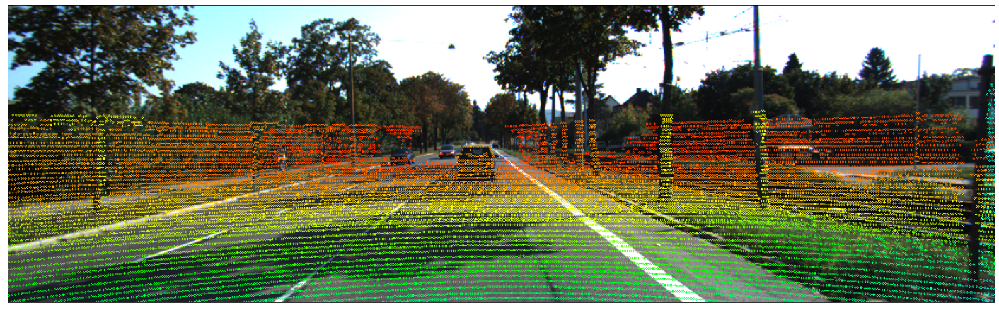

In [178]:
cmap = plt.cm.get_cmap('hsv', 256)
cmap = np.array([cmap(i) for i in range(256)])[:, :3] * 255

img=np.copy(rgb)
for i in range(imgfov_pc_pixel.shape[1]):#19423
    depth = imgfov_pc_cam2[2, i]
    color = cmap[int(640.0 / depth), :]#different depth with different color
    cv2.circle(img, (int(np.round(imgfov_pc_pixel[0, i])),
                     int(np.round(imgfov_pc_pixel[1, i]))),
               1, color=tuple(color), thickness=0) #Thickness of -1 px will fill the circle shape by the specified color.
plt.imshow(img)
plt.yticks([])
plt.xticks([])
plt.show()

In [179]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt

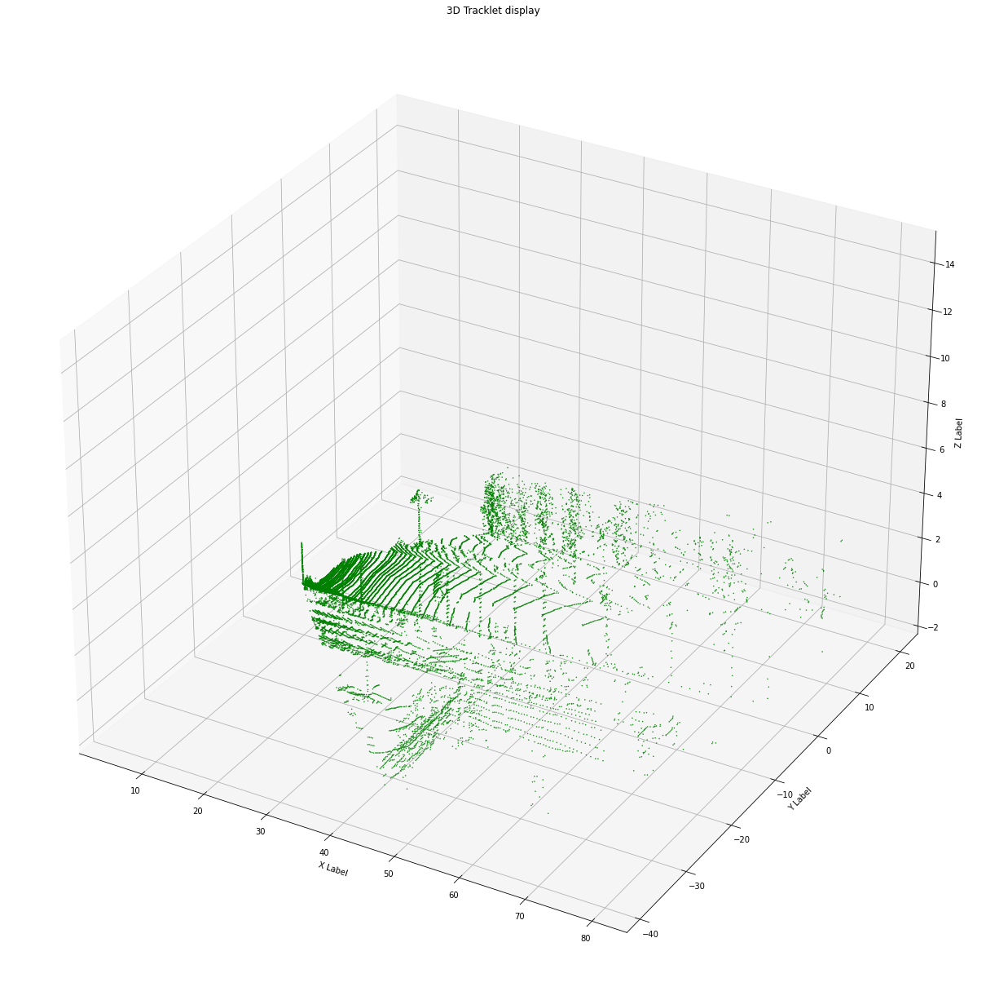

In [185]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(30, 22))
ax = fig.add_subplot(111, projection='3d')
plt.title("3D Tracklet display")
pnt = imgfov_pc_velo.T[:, 1::1] # one point in 5 points

ax.scatter(*pnt, s = 1, c='g', marker='.', alpha=1)
#draw_3d_box(tracklet_, type_)

ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

# ax.set_xlim3d(-10,30)
# ax.set_ylim3d(-20,20)
ax.set_zlim3d(-2,15)

plt.show()

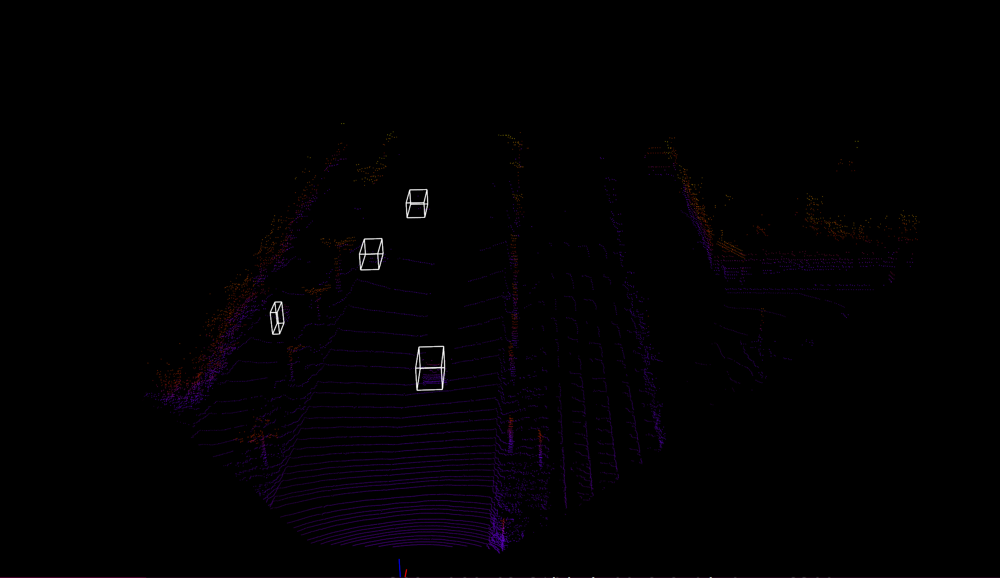

In [172]:
from IPython.display import Image 
pil_img = Image(filename='figs/lidarvis.png')
display(pil_img)

# Test PseudoLidar v2

## Convert the KITTI velodyne ground truths to depth maps.
(Newenv) kaikai@kaikai-i9new:~/Documents/PyCharmremote/PseudoLidar/Pseudo_Lidar_V2-master$ python3 ./src/preprocess/generate_depth_map.py --data_path /mnt/data5T/Share/Dataset/Kitti/object/training/ --split_file ./split/trainval.txt

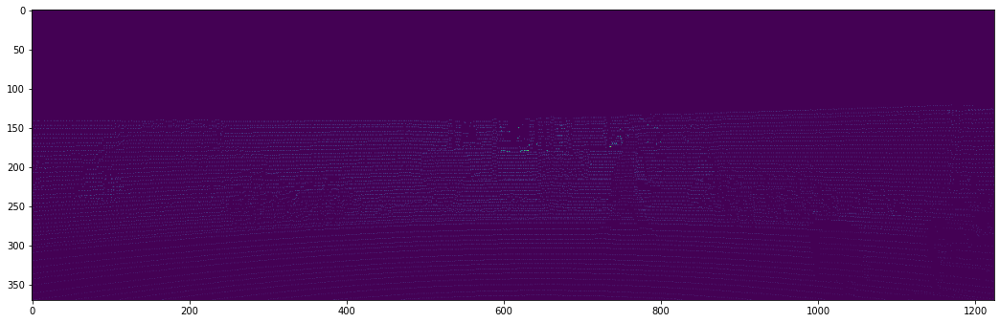

In [17]:
depthimgpath='/mnt/DATA5T/Share/Dataset/Kitti/object/training/depth_map/000000.npy'
import numpy as np

img_array = np.load(depthimgpath)

from matplotlib import pyplot as plt
plt.figure(figsize=(18,15))
plt.imshow(img_array)
plt.show()

In [18]:
img_array

array([[-1.        , -1.        , -1.        , ..., -1.        ,
        -1.        , -1.        ],
       [-1.        , -1.        , -1.        , ..., -1.        ,
        -1.        , -1.        ],
       [-1.        , -1.        , -1.        , ..., -1.        ,
        -1.        , -1.        ],
       ...,
       [-1.        , -1.        , -1.        , ..., -1.        ,
        -1.        , -1.        ],
       [-1.        , -1.        , -1.        , ..., -1.        ,
         5.35577567, -1.        ],
       [-1.        , -1.        , -1.        , ..., -1.        ,
        -1.        , -1.        ]])

In [19]:
np.max(img_array)

72.72496954215286

In [20]:
np.min(img_array)

-1.0

In [21]:
img_array_adjust=np.clip(img_array*20, 0, 255, out=None)

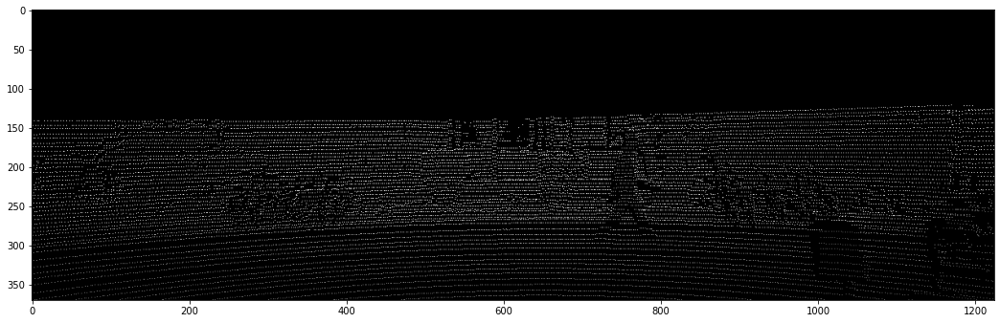

In [22]:
plt.figure(figsize=(18,15))
plt.imshow(img_array_adjust, cmap='gray')
plt.show()

## Generate Predictions
(Newenv) kaikai@kaikai-i9new:~/Documents/PyCharmremote/PseudoLidar/Pseudo_Lidar_V2-master$ python3 ./src/main.py --config ./src/configs/sdn_kitti_train.config --resume ./sdn_kitti_object.pth --dataset kitti --datapath /mnt/data5T/Share/Dataset/Kitti/object/training/ --data_list ./split/trainval.txt --generate_depth_map --data_tag trainval

In [23]:
depthimgpath='/home/kaikai/Documents/PyCharmremote/PseudoLidar/Pseudo_Lidar_V2-master/results/sdn_kitti_train_set/depth_maps/trainval/000000.npy'
import numpy as np

img_array = np.load(depthimgpath)

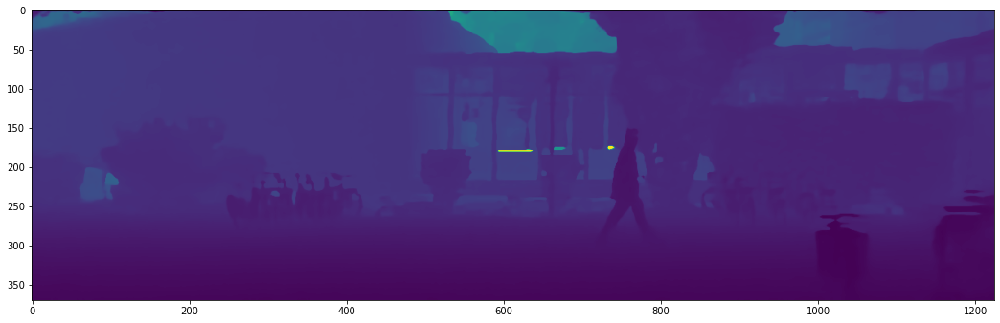

In [24]:
#predicted depth map
from matplotlib import pyplot as plt
plt.figure(figsize=(18,15))
plt.imshow(img_array)
plt.show()

## Convert depth maps to Pseudo-Lidar Point Clouds
python3 ./src/preprocess/generate_lidar_from_depth.py --calib_dir  /mnt/data5T/Share/Dataset/Kitti/object/training/calib \
    --depth_dir ./results/sdn_kitti_train_set/depth_maps/trainval/  \
    --save_dir  ./results/sdn_kitti_train_set/pseudo_lidar_trainval/


In [28]:
pseudolidarpath='/home/kaikai/Documents/PyCharmremote/PseudoLidar/Pseudo_Lidar_V2-master/results/sdn_kitti_train_set/pseudo_lidar_trainval/'

In [32]:
!ls $pseudolidarpath

000000.bin  001247.bin	002494.bin  003741.bin	004988.bin  006235.bin
000001.bin  001248.bin	002495.bin  003742.bin	004989.bin  006236.bin
000002.bin  001249.bin	002496.bin  003743.bin	004990.bin  006237.bin
000003.bin  001250.bin	002497.bin  003744.bin	004991.bin  006238.bin
000004.bin  001251.bin	002498.bin  003745.bin	004992.bin  006239.bin
000005.bin  001252.bin	002499.bin  003746.bin	004993.bin  006240.bin
000006.bin  001253.bin	002500.bin  003747.bin	004994.bin  006241.bin
000007.bin  001254.bin	002501.bin  003748.bin	004995.bin  006242.bin
000008.bin  001255.bin	002502.bin  003749.bin	004996.bin  006243.bin
000009.bin  001256.bin	002503.bin  003750.bin	004997.bin  006244.bin
000010.bin  001257.bin	002504.bin  003751.bin	004998.bin  006245.bin
000011.bin  001258.bin	002505.bin  003752.bin	004999.bin  006246.bin
000012.bin  001259.bin	002506.bin  003753.bin	005000.bin  006247.bin
000013.bin  001260.bin	002507.bin  003754.bin	005001.bin  006248.bin
000014.bin  001261.bin	002508.bin 

![alt text](figs/pseudolidar1.png "Title")

# Test Argo converted to Kitti

In [186]:
!ls /mnt/DATA5T/Argoverse/argoverse-conv-rect-mynew/ #converted data folder, only used train1

training


In [187]:
!ls /mnt/DATA5T/Argoverse/argoverse-conv-rect-mynew/training

argo_kitti_link.txt  image_2  label_2	 val.txt
calib		     image_3  train.txt  velodyne


In [195]:
!ls /mnt/DATA5T/Argoverse/argoverse-conv-rect-mynew/training/calib

000000.txt  000318.txt	000636.txt  000954.txt	001272.txt  001590.txt
000001.txt  000319.txt	000637.txt  000955.txt	001273.txt  001591.txt
000002.txt  000320.txt	000638.txt  000956.txt	001274.txt  001592.txt
000003.txt  000321.txt	000639.txt  000957.txt	001275.txt  001593.txt
000004.txt  000322.txt	000640.txt  000958.txt	001276.txt  001594.txt
000005.txt  000323.txt	000641.txt  000959.txt	001277.txt  001595.txt
000006.txt  000324.txt	000642.txt  000960.txt	001278.txt  001596.txt
000007.txt  000325.txt	000643.txt  000961.txt	001279.txt  001597.txt
000008.txt  000326.txt	000644.txt  000962.txt	001280.txt  001598.txt
000009.txt  000327.txt	000645.txt  000963.txt	001281.txt  001599.txt
000010.txt  000328.txt	000646.txt  000964.txt	001282.txt  001600.txt
000011.txt  000329.txt	000647.txt  000965.txt	001283.txt  001601.txt
000012.txt  000330.txt	000648.txt  000966.txt	001284.txt  001602.txt
000013.txt  000331.txt	000649.txt  000967.txt	001285.txt  001603.txt
000014.txt  000332.txt	000650.txt 

In [196]:
!cat /mnt/DATA5T/Argoverse/argoverse-conv-rect-mynew/training/calib/000000.txt

P0: 0 0 0 0 0 0 0 0 0 0 0 0
P1: 0 0 0 0 0 0 0 0 0 0 0 0
P2: 3847.627269051659 0.0 1298.5062408447266 0.0 0.0 3847.627269051659 1058.2544479370117 0.0 0.0 0.0 1.0 0.0
P3: 3847.627269051659 0.0 1298.5062408447266 -1162.9078535435208 0.0 3847.627269051659 1058.2544479370117 0.0 0.0 0.0 1.0 0.0
R0_rect: 0.9996430618373844 0.01201558303230566 -0.023861573392658455 -0.012168962128943049 0.999906152249861 -0.006293095707366216 0.023783718823678683 0.006581220044299509 0.9996954647599661
Tr_velo_to_cam: -0.005973898515583276 -0.9999595075703314 0.006730212197699148 0.15994814173597732 0.012856855421820468 -0.0068065811729352 -0.9998941802617909 1.357454597473856 0.9998995018526553 -0.005886736994022257 0.012896996641671765 -1.6172942889332544
Tr_imu_to_velo: 0 0 0 0 0 0 0 0 0 0 0 0
    

In [188]:
!cat /mnt/DATA5T/Argoverse/argoverse-conv-rect-mynew/training/argo_kitti_link.txt

000000, logID:88538208-8853-8853-8853-388539396096, LiDAR:315968261620332000, Left_Cam:stereo_front_left_315968261626139136, Right_Cam:stereo_front_right_315968261626139464
000001, logID:88538208-8853-8853-8853-388539396096, LiDAR:315968261820062000, Left_Cam:stereo_front_left_315968261825940256, Right_Cam:stereo_front_right_315968261825939944
000002, logID:88538208-8853-8853-8853-388539396096, LiDAR:315968262020449000, Left_Cam:stereo_front_left_315968262025741376, Right_Cam:stereo_front_right_315968262025740584
000003, logID:88538208-8853-8853-8853-388539396096, LiDAR:315968262220178000, Left_Cam:stereo_front_left_315968262225542096, Right_Cam:stereo_front_right_315968262225540856
000004, logID:88538208-8853-8853-8853-388539396096, LiDAR:315968262419908000, Left_Cam:stereo_front_left_315968262425340976, Right_Cam:stereo_front_right_315968262425340056
000005, logID:88538208-8853-8853-8853-388539396096, LiDAR:315968262620301000, Left_Cam:stereo_front_left_315968262625139840, Right_Cam:

In [191]:
!cat /mnt/DATA5T/Argoverse/argoverse-conv-rect-mynew/training/train.txt

000000
000001
000002
000003
000004
000005
000006
000007
000008
000009
000010
000011
000012
000013
000014
000015
000016
000017
000018
000019
000020
000021
000022
000023
000024
000025
000026
000027
000028
000029
000030
000031
000032
000033
000034
000035
000036
000037
000038
000039
000040
000041
000042
000043
000044
000045
000046
000047
000048
000049
000050
000051
000052
000053
000054
000055
000056
000057
000058
000059
000060
000061
000062
000063
000064
000065
000066
000067
000068
000069
000070
000071
000072
000073
000074
000075
000076
000077
000078
000079
000080
000081
000082
000083
000084
000085
000086
000087
000088
000089
000090
000091
000092
000093
000094
000095
000096
000097
000098
000099
000100
000101
000102
000103
000104
000105
000106
000107
000108
000109
000110
000111
000112
000113
000114
000115
000116
000117
000118
000119
000120
000121
000122
000123
000124
000125
000126
000127
000128
000129
000130
000131
000132
000133
000134
000135
000136
000137
000138
000139
000140
000141
000142

In [192]:
!ls /mnt/DATA5T/Argoverse/argoverse-conv-rect-mynew/training/velodyne

000000.bin  000318.bin	000636.bin  000954.bin	001272.bin  001590.bin
000001.bin  000319.bin	000637.bin  000955.bin	001273.bin  001591.bin
000002.bin  000320.bin	000638.bin  000956.bin	001274.bin  001592.bin
000003.bin  000321.bin	000639.bin  000957.bin	001275.bin  001593.bin
000004.bin  000322.bin	000640.bin  000958.bin	001276.bin  001594.bin
000005.bin  000323.bin	000641.bin  000959.bin	001277.bin  001595.bin
000006.bin  000324.bin	000642.bin  000960.bin	001278.bin  001596.bin
000007.bin  000325.bin	000643.bin  000961.bin	001279.bin  001597.bin
000008.bin  000326.bin	000644.bin  000962.bin	001280.bin  001598.bin
000009.bin  000327.bin	000645.bin  000963.bin	001281.bin  001599.bin
000010.bin  000328.bin	000646.bin  000964.bin	001282.bin  001600.bin
000011.bin  000329.bin	000647.bin  000965.bin	001283.bin  001601.bin
000012.bin  000330.bin	000648.bin  000966.bin	001284.bin  001602.bin
000013.bin  000331.bin	000649.bin  000967.bin	001285.bin  001603.bin
000014.bin  000332.bin	000650.bin 

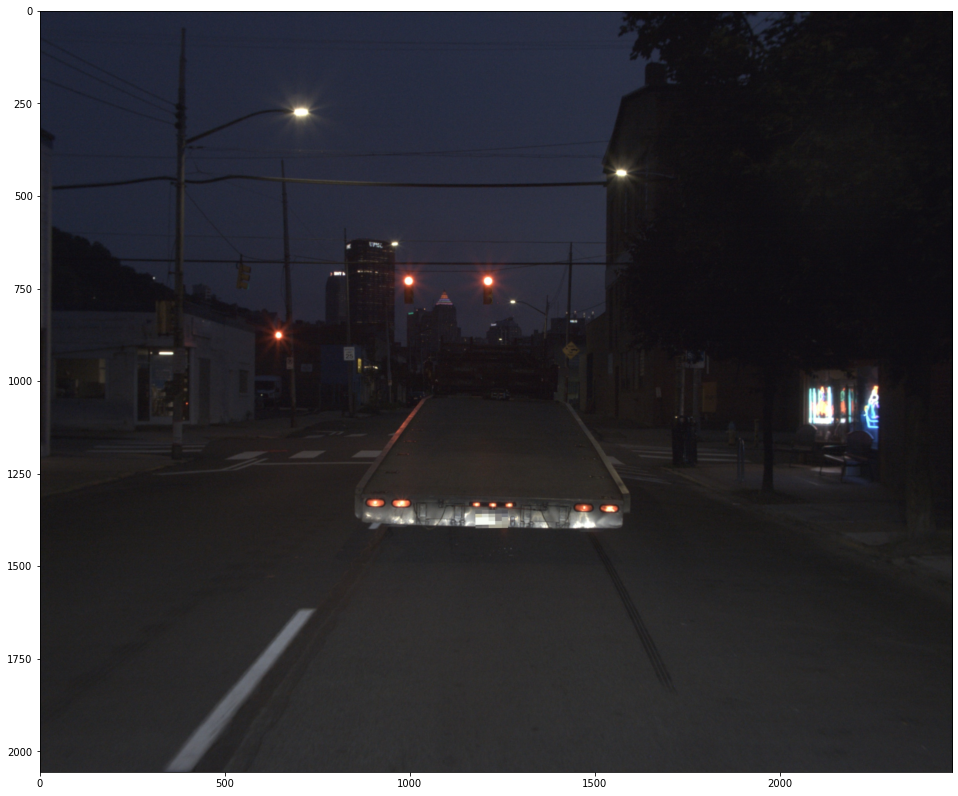

In [197]:
import cv2
import os
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (25, 14)

Basepath='/mnt/DATA5T/Argoverse/argoverse-conv-rect-mynew/training'
filename='000007.png'
image_file = path = os.path.join(Basepath, 'image_2', filename)
calibration_file = os.path.join(Basepath, 'calib', filename.replace('png', 'txt'))
label_file = os.path.join(Basepath, 'label_2', filename.replace('png', 'txt'))
labels = read_label_3d(label_file)
img = cv2.imread(image_file)

rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_height, img_width, img_channel = rgb.shape
plt.imshow(rgb)

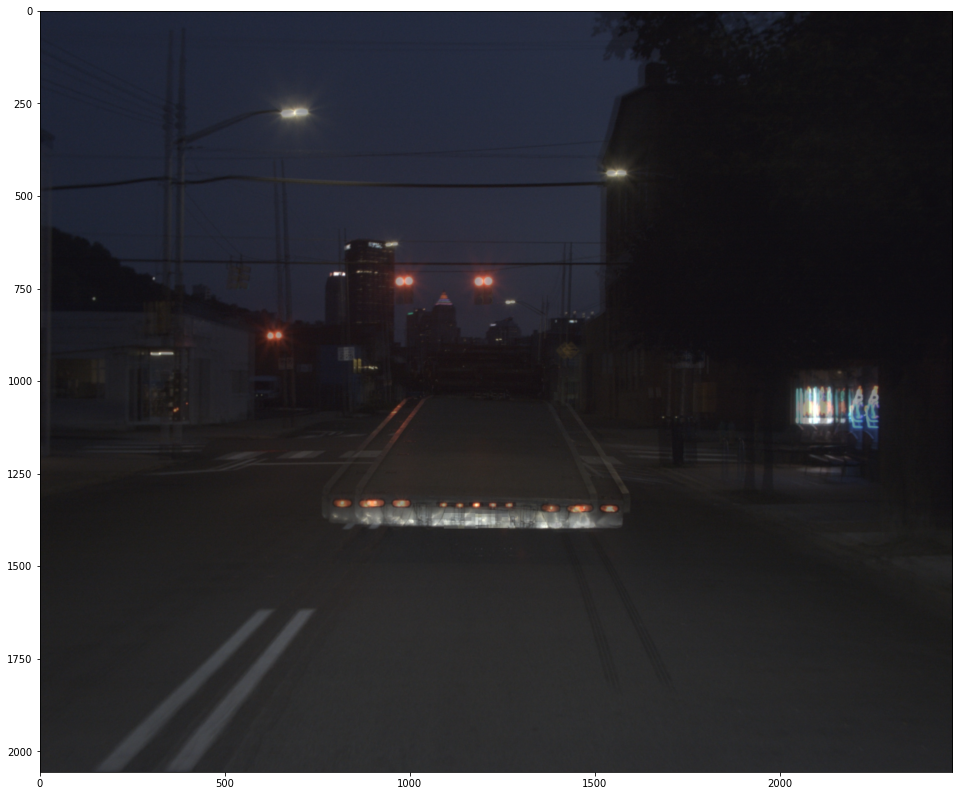

In [198]:
img3_path=image_file.replace('image_2', 'image_3')
img3 = cv2.imread(img3_path)
rgb2 = cv2.cvtColor(img3, cv2.COLOR_BGR2RGB)
plt.imshow(rgb2)
combined = cv2.addWeighted(rgb,0.5,rgb2,0.5,0)
plt.imshow(combined)

![alt text](figs/argokittivis.png "Title")

## Depth map

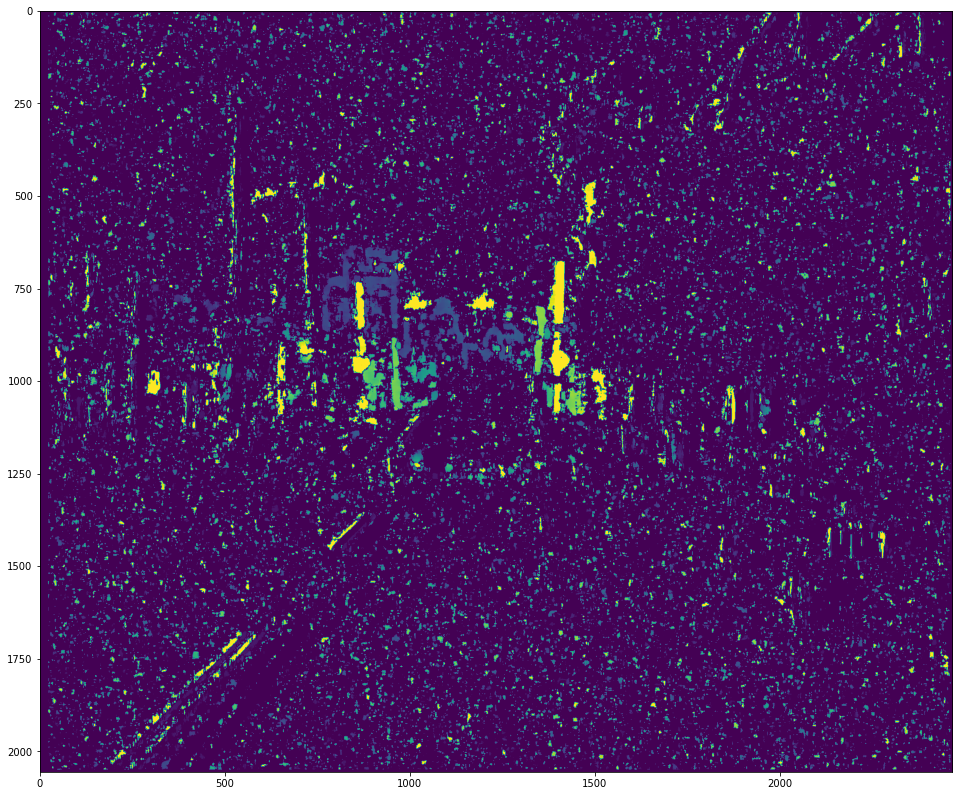

In [202]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt
imgL = cv.imread('/mnt/DATA5T/Argoverse/argoverse-conv-rect-mynew/training/image_2/000000.png',0)
imgR = cv.imread('/mnt/DATA5T/Argoverse/argoverse-conv-rect-mynew/training/image_3/000000.png',0)
stereo = cv.StereoBM_create(numDisparities=16, blockSize=15)
disparity = stereo.compute(imgL,imgR)
plt.imshow(disparity)#,'gray')


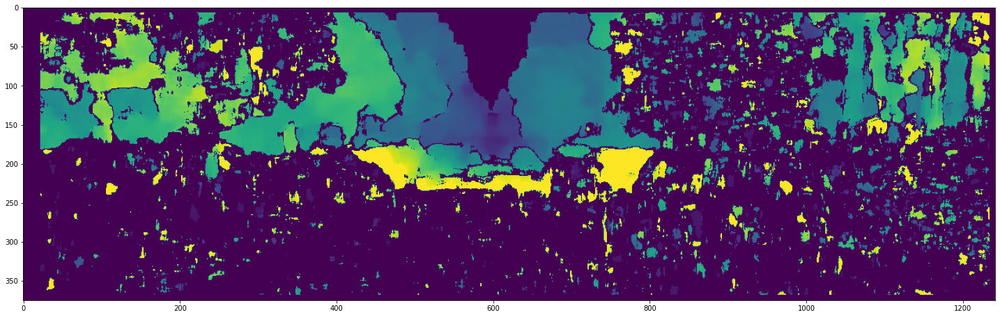

In [194]:


import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt
imgL = cv.imread('/mnt/DATA5T/Share/Dataset/Kitti/object/training/image_2/000169.png',0)
imgR = cv.imread('/mnt/DATA5T/Share/Dataset/Kitti/object/training/image_3/000169.png',0)
stereo = cv.StereoBM_create(numDisparities=16, blockSize=15)
disparity = stereo.compute(imgL,imgR)
plt.imshow(disparity)#,'gray')